Updated from: topic_modeling_with_sklearn

Modularized code

Works for random subsample of microbiome data

Determine optimal number of topics using perplexity as a measure of how well LDA fits the data.

9/21/17: 500 random subsamples from fungal dataset, max_iter=100, n_topics=200, threshold=1e-5 applied to lda-transformed tf matrix


In [121]:
from __future__ import print_function
from __future__ import division
from time import time

from sklearn.feature_extraction.text import CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation

import sys, os

import biom
from biom import parse_table, load_table

from numpy import array
import numpy as np
from scipy.sparse import csr_matrix

import matplotlib.pyplot as plt
%matplotlib inline

import pandas as pd
import csv

from collections import defaultdict

from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D

import itertools # for flattening 2D lists

from mpl_toolkits.basemap import Basemap

from scipy.stats import kurtosis, skew

In [2]:
def load_data(fname,num_sample):
    with open(fname) as f: 
        table = parse_table(f)
    
    # randomly subsample without replacement
    samp_table = table.subsample(num_sample,axis='sample',by_id=True)
    df = samp_table.to_dataframe()
       
    otus = [otu for otu in samp_table.ids(axis='observation')] # 'words'
    samples = [samp for samp in samp_table.ids()] # 'documents'
    
    n = len(samples)  # number of 'samples' or 'articles'
    m = len(otus)  # number of 'features' or 'words'
    
    otu_ids = array(list(xrange(m)))  # indices for 'words' in the dictionary
    samp_ids = array(list(xrange(n))) # indices for 'documents' in the corpus
    
    # construct at compressed sparse row format matrix, to represent the term-frequency (tf)
    # matrix
    tf = csr_matrix(df.values.reshape((n,m)))   
    
    # construct the dictionary, i.e. mapping from 'word IDs' to 'words'
    vocab = dict(zip(otu_ids, otus))
    
    return(tf,vocab,samples)

In [3]:
os.chdir('data/otu_tables_wTax')
fname = 'ITS_otu_table_wTax.biom'
num_sample = 500 # number of random subsamples
tf,vocab,samples = load_data(fname,num_sample)

In [4]:
print(tf.shape)

(500, 48881)


In [5]:
print(len(vocab))

48881


In [6]:
def print_top_words(model, feature_names, n_top_words):
    for topic_idx, topic in enumerate(model.components_):
        message = "Topic #%d: " % topic_idx
        message += " ".join([str(vocab[feature_names[i]])
                             for i in topic.argsort()[:-n_top_words - 1:-1]])
        #message += " ".join([str(feature_names[i])
        #                     for i in topic.argsort()[:-n_top_words - 1:-1]])
        print(message)
    print()
    
def find_words_per_topic(model,feature_names,n_top_words):
    topic_data = defaultdict(list)
    for topic_idx, topic in enumerate(model.components_):
        # list of sample IDs
        topic_data[topic_idx].append([str(vocab[feature_names[i]]) 
                                     for i in topic.argsort()[:-n_top_words -1:-1]]) 
    return(topic_data)    

def run_lda(n_topics,max_iter,tf,vocab):
    tf_vectorizer = CountVectorizer(max_df=1.0,min_df=0.0,vocabulary=list(set(vocab)))
    lda = LatentDirichletAllocation(n_components=n_topics, max_iter=max_iter,
                                learning_method='online',
                                learning_offset=50.,
                                random_state=0)
    lda.fit(tf)
    return(lda,tf_vectorizer)

In [7]:
n_topics = 10  #number of topics
max_iter = 50

lda,tf_vectorizer = run_lda(n_topics,max_iter,tf,vocab)

print("\nTopics in LDA model:")
tf_vectorizer._validate_vocabulary()
tf_feature_names = tf_vectorizer.get_feature_names()

n_top_words = 20
print_top_words(lda, tf_feature_names, n_top_words)


Topics in LDA model:
Topic #0: OTU_10231 OTU_24385 OTU_32764 OTU_75134 OTU_57832 OTU_9208 OTU_2607 OTU_6763 OTU_21390 OTU_41331 OTU_62018 OTU_19887 OTU_53289 OTU_41707 OTU_19970 OTU_52386 OTU_14472 OTU_43001 OTU_58679 OTU_74242
Topic #1: OTU_68271 OTU_5394 OTU_6089 OTU_69997 OTU_70146 OTU_31433 OTU_5558 OTU_30721 OTU_61415 OTU_74468 OTU_16715 OTU_55611 OTU_2871 OTU_51000 OTU_24468 OTU_54626 OTU_60548 OTU_37474 OTU_5638 OTU_26382
Topic #2: OTU_60908 OTU_64451 OTU_14577 OTU_26113 OTU_16632 OTU_4461 OTU_17472 OTU_10809 OTU_64461 OTU_64137 OTU_73327 OTU_69906 OTU_21666 OTU_4643 OTU_53678 OTU_9231 OTU_5257 OTU_67037 OTU_24926 OTU_4010
Topic #3: OTU_23811 OTU_4135 OTU_12860 OTU_52495 OTU_49554 OTU_74555 OTU_2306 OTU_32800 OTU_32573 OTU_46661 OTU_47573 OTU_54310 OTU_63027 OTU_74562 OTU_29346 OTU_32785 OTU_46975 OTU_8963 OTU_5105 OTU_61812
Topic #4: OTU_74336 OTU_24695 OTU_14128 OTU_31875 OTU_15160 OTU_4176 OTU_49652 OTU_46162 OTU_60927 OTU_1475 OTU_64141 OTU_74121 OTU_14165 OTU_11230 OTU_511

In [8]:
topic_data = find_words_per_topic(lda,tf_feature_names,100)
print(topic_data[0])

[['OTU_10231', 'OTU_24385', 'OTU_32764', 'OTU_75134', 'OTU_57832', 'OTU_9208', 'OTU_2607', 'OTU_6763', 'OTU_21390', 'OTU_41331', 'OTU_62018', 'OTU_19887', 'OTU_53289', 'OTU_41707', 'OTU_19970', 'OTU_52386', 'OTU_14472', 'OTU_43001', 'OTU_58679', 'OTU_74242', 'OTU_30131', 'OTU_6293', 'OTU_3514', 'OTU_68952', 'OTU_61402', 'OTU_7991', 'OTU_60656', 'OTU_48561', 'OTU_35622', 'OTU_65917', 'OTU_4171', 'OTU_2752', 'OTU_2865', 'OTU_24727', 'OTU_17501', 'OTU_56121', 'OTU_61373', 'OTU_60609', 'OTU_6676', 'OTU_8634', 'OTU_33978', 'OTU_49536', 'OTU_6966', 'OTU_58414', 'OTU_68594', 'OTU_8030', 'OTU_5663', 'OTU_440', 'OTU_355', 'OTU_36706', 'OTU_23001', 'OTU_6004', 'OTU_38082', 'OTU_8468', 'OTU_51659', 'OTU_749', 'OTU_35324', 'OTU_26228', 'OTU_37220', 'OTU_46411', 'OTU_58856', 'OTU_18863', 'OTU_63577', 'OTU_32280', 'OTU_9156', 'OTU_67619', 'OTU_37332', 'OTU_43096', 'OTU_69202', 'OTU_20312', 'OTU_939', 'OTU_23092', 'OTU_10916', 'OTU_65479', 'OTU_63802', 'OTU_13061', 'OTU_17593', 'OTU_4910', 'OTU_44619

In [9]:
n_topics = 40  #number of topics
max_iter = 100

lda,tf_vectorizer = run_lda(n_topics,max_iter,tf,vocab)

print("\nTopics in LDA model:")
tf_vectorizer._validate_vocabulary()
tf_feature_names = tf_vectorizer.get_feature_names()

n_top_words = 20
print_top_words(lda, tf_feature_names, n_top_words)

topic_data = find_words_per_topic(lda,tf_feature_names,100)
print(topic_data[0])


Topics in LDA model:
Topic #0: OTU_21390 OTU_7991 OTU_35622 OTU_17501 OTU_6004 OTU_749 OTU_46411 OTU_13358 OTU_15591 OTU_28525 OTU_4697 OTU_19624 OTU_73058 OTU_8574 OTU_52869 OTU_19584 OTU_64588 OTU_8467 OTU_16342 OTU_47120
Topic #1: OTU_68271 OTU_5394 OTU_6089 OTU_69997 OTU_70146 OTU_31433 OTU_5558 OTU_30721 OTU_61415 OTU_74468 OTU_16715 OTU_55611 OTU_2871 OTU_51000 OTU_24468 OTU_54626 OTU_60548 OTU_37474 OTU_5638 OTU_26382
Topic #2: OTU_60908 OTU_64451 OTU_14577 OTU_26113 OTU_16632 OTU_17472 OTU_64461 OTU_64137 OTU_73327 OTU_69906 OTU_21666 OTU_53678 OTU_9231 OTU_5257 OTU_67037 OTU_4010 OTU_24926 OTU_55629 OTU_43984 OTU_62265
Topic #3: OTU_37333 OTU_47975 OTU_14033 OTU_51444 OTU_57449 OTU_46605 OTU_29753 OTU_15878 OTU_17333 OTU_66314 OTU_30455 OTU_13676 OTU_9756 OTU_5654 OTU_4031 OTU_15723 OTU_6573 OTU_14669 OTU_71734 OTU_74449
Topic #4: OTU_61847 OTU_76063 OTU_20139 OTU_28065 OTU_56760 OTU_59968 OTU_23489 OTU_70518 OTU_9893 OTU_37963 OTU_8044 OTU_29295 OTU_9329 OTU_37570 OTU_50568 

[['OTU_21390', 'OTU_7991', 'OTU_35622', 'OTU_17501', 'OTU_6004', 'OTU_749', 'OTU_46411', 'OTU_13358', 'OTU_15591', 'OTU_28525', 'OTU_4697', 'OTU_19624', 'OTU_73058', 'OTU_8574', 'OTU_52869', 'OTU_19584', 'OTU_64588', 'OTU_8467', 'OTU_16342', 'OTU_47120', 'OTU_32099', 'OTU_19688', 'OTU_46659', 'OTU_76162', 'OTU_1705', 'OTU_7676', 'OTU_9658', 'OTU_27042', 'OTU_69943', 'OTU_34013', 'OTU_42541', 'OTU_2542', 'OTU_8432', 'OTU_63499', 'OTU_51238', 'OTU_1178', 'OTU_27089', 'OTU_70539', 'OTU_35005', 'OTU_50958', 'OTU_51210', 'OTU_30272', 'OTU_23452', 'OTU_39721', 'OTU_15076', 'OTU_68019', 'OTU_17101', 'OTU_68298', 'OTU_42265', 'OTU_31327', 'OTU_12581', 'OTU_59669', 'OTU_65654', 'OTU_5117', 'OTU_20057', 'OTU_17221', 'OTU_45223', 'OTU_69450', 'OTU_1266', 'OTU_2718', 'OTU_21242', 'OTU_35899', 'OTU_42842', 'OTU_9471', 'OTU_33144', 'OTU_75037', 'OTU_8056', 'OTU_62169', 'OTU_17700', 'OTU_55593', 'OTU_36991', 'OTU_43382', 'OTU_52789', 'OTU_3787', 'OTU_19393', 'OTU_14357', 'OTU_16962', 'OTU_7154', 'OTU

In [10]:
# to find max_iter, fix n_topics, vary max_iter, and see at what point perplexity converges
def find_opt_iters(n_topics,tf):
    iters = [10,50,100,200]
    perp = []
    for it in iters:
        lda = LatentDirichletAllocation(n_components=n_topics, max_iter=it,
                                learning_method='online',
                                learning_offset=50.,
                                random_state=0)
        lda.fit(tf)
        perp.append(lda.perplexity(tf).tolist())
    return(iters,perp)

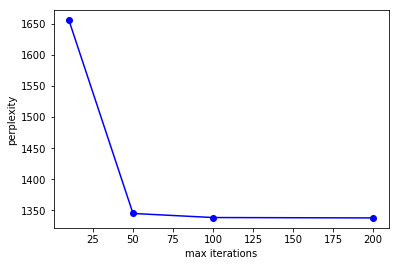

In [11]:
n_topics = 100
iters,perp = find_opt_iters(n_topics,tf)
plt.plot(iters,perp,'bo-')
plt.xlabel('max iterations')
plt.ylabel('perplexity')

In [12]:
# now vary the number of topics and plot perplexity, score as function of # topics
def find_opt_ntopics(tf):
    n_topics = [10,50,100,150,200,250]
    scores = []
    perp = []
    for n in n_topics:
        lda = LatentDirichletAllocation(n_components=n, max_iter=100,
                                learning_method='online',
                                learning_offset=50.,
                                random_state=0)
        lda.fit(tf)
        scores.append(lda.score(tf).tolist())
        perp.append(lda.perplexity(tf).tolist())
    return(n_topics,scores,perp)

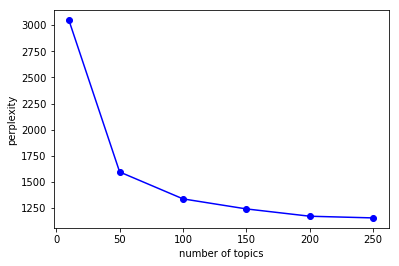

In [28]:
#n_topics,scores,perp = find_opt_ntopics(tf)
plt.plot(n_topics,perp,'bo-')
plt.xlabel('number of topics')
plt.ylabel('perplexity')

In [26]:
print(n_topics)
print(perp)

# [10, 50, 100, 150, 200, 250]
# [3046.933923517172, 1596.1291598637351, 1338.5161472162142, 1242.5372325901603, 1172.6691437187278, 1156.5897174661427]

[10, 50, 100, 150, 200, 250]
[3046.933923517172, 1596.1291598637351, 1338.5161472162142, 1242.5372325901603, 1172.6691437187278, 1156.5897174661427]


In [29]:
# now select the optimum n_topics
n_topics = 200
max_iter = 100
lda,tf_vectorizer = run_lda(n_topics,max_iter,tf,vocab)
tf_fit = lda.fit_transform(tf) 

In [30]:
# pickle the model and fit
import pickle

output = open('lda.pkl', 'wb')

# Pickle lda using protocol 0.
pickle.dump(lda, output)

# Pickle the tf_vectorizer
pickle.dump(tf_vectorizer, output)

# Pickel the tf_fit matrix
pickle.dump(tf_fit, output)

output.close()

In [ ]:
# to read from pickle
import pprint, pickle

pkl_file = open('lda.pkl', 'rb')

lda = pickle.load(pkl_file)
pprint.pprint(lda)

tf_vectorizer = pickle.load(pkl_file)
pprint.pprint(tf_vectorizer)

tf_fit = pickle.load(tf_fit)
pprint.pprint(tf_fit)

pkl_file.close()

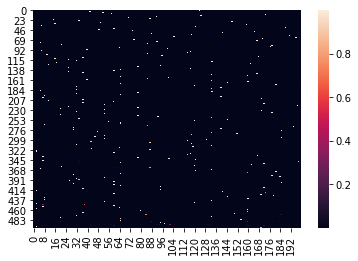

In [31]:
import seaborn as sns
sns.heatmap(tf_fit) # [n_samples x n_topics]

In [32]:
# for each topic, make vector containing the samples with non-zero weight in that topic 
# print first column, corresponding to the first topic. want to find the coordinates in this 
# topic projection that are larger than some threshold, say 1e-2
print(tf_fit[:,0])

[  2.80518931e-10   1.47320447e-09   2.06554128e-09   3.61663130e-09
   3.50024362e-09   4.01386872e-09   6.14477835e-09   5.33888577e-09
   8.04781043e-09   1.51389911e-08   9.75236787e-09   1.55014726e-08
   1.14779463e-08   9.90057839e-09   1.69592706e-08   1.18108655e-08
   1.05223948e-08   1.83982485e-08   1.68547659e-08   1.65396969e-08
   2.09486381e-08   1.65283792e-08   2.14998280e-08   1.58981501e-08
   2.86680810e-08   1.93179228e-08   2.28960793e-08   2.08574933e-08
   3.13463901e-08   2.21418228e-08   3.61399628e-08   3.77162082e-08
   2.16008848e-08   9.03615002e-09   3.18981301e-08   3.60199406e-08
   2.82704692e-08   2.00080833e-08   4.08573506e-08   5.04281349e-08
   3.31976655e-08   4.13578613e-08   3.22108911e-08   5.03986533e-08
   3.27332242e-08   4.85611336e-08   6.65920835e-08   4.83171149e-08
   5.82682671e-08   4.70415565e-08   6.75255922e-08   4.58505273e-08
   5.14085955e-08   4.66000596e-08   6.26762770e-08   4.07444832e-08
   6.15278598e-08   6.90178756e-08

In [37]:
# need to remove the '.O' or '.I' at the end of each sample ID 
samp_type = [None] * len(samples) # save sample type as 0 or 1 depending on if it was an outdoor or indoor sample
samples_new = [None] * len(samples)
for i in range(len(samples)):
    if '.O' in str(samples[i]):
        samp_type[i] = 0
        temp = str(samples[i]).replace('.O','')
        if(temp.isdigit()):
            samples_new[i] = int(temp)  
    elif '.I' in str(samples[i]):
        samp_type[i] = 1 
        temp = str(samples[i]).replace('.I','')
        if(temp.isdigit()):
            samples_new[i] = int(temp)     
print(samples_new)

[242, 830, 737, 781, 985, 978, 921, 399, 897, 662, 758, 962, 331, 123, 625, 809, 1231, 713, 243, 986, 192, 741, 351, 375, 30, 966, 1165, 66, 997, 615, 554, 509, 106, 684, 915, 964, 258, 744, 1265, 536, 182, 37, 1274, 428, 648, 732, 812, 566, 685, 693, 783, 327, 649, 593, 774, 185, 983, 228, 773, 44, 860, 526, 473, 563, 118, 435, 674, 465, 1240, 814, 208, 279, 314, 416, 268, 872, 230, 560, 761, 1178, 768, 1018, 561, 571, 499, 865, 210, 236, 920, 547, 266, 1084, 586, 938, 107, 687, 1181, 701, 72, 540, 800, 935, 530, 965, 495, 667, 847, 367, 1205, 1004, 119, 294, 1006, 1293, 308, 917, 353, 726, 12, 1045, 1268, 321, 683, 1136, 1037, 1188, 140, 778, 462, 460, 1063, 844, 39, 475, 1177, 1081, 888, 850, 1019, 1083, 1206, 557, 429, 937, 175, 1204, 1073, 895, 215, 1173, 430, 20, 819, 41, 257, 686, 606, 1244, 1182, 15, 1214, 837, 1189, 926, 405, 1021, 484, 901, 1128, 1051, 498, 552, 224, None, 65, 767, 59, 384, 292, 212, 314, 173, 834, 412, 575, 227, 1193, 936, 133, 550, 195, 685, 331, 286, 573, 

In [38]:
# now for each community/topic, store a matrix of samples, locations + metadata assoc with 
# that sample
# create an empty pandas dataframe and populate it with this info

#import pandas as pd
#import csv

# index of the topics/communities; these will be the rows of the dataFrame
index = array(list(xrange(n_topics)))

columns = ['Samples','SampleType','Cities','States','Lat','Long','MeanAnnTemps','MeanAnnPrec','NetPrimProd','Elevation']

In [39]:
# load metadata
os.chdir('..')
fname = 'homes_mapping_file.txt'

with open(fname) as f:
    lines = f.readlines()
with open(fname,'r') as f:
    df = pd.read_csv(f,sep='\t')
df.head()

,ID,City,State,Latitude,Longitude,MeanAnnual Temperature,MeanAnnualPrecipitation,NetPrimaryProductivity,Elevation,Residence,NumberBedroooms
0,12,Hopkinton,NH,43.2,-71.7,6.960092,87.594419,2.144496,222.669723,A mobile home,3
1,13,Albuquerque,NM,35.1,-106.5,10.761468,26.163609,0.621555,1708.676392,One-family house detached from any other house,3
2,14,Savannah,GA,32.1,-81.1,19.113914,102.441208,2.431254,11.967500,One-family house detached from any other house,2
3,15,Renton,WA,47.4,-122.1,11.172859,85.494190,2.186705,144.733032,One-family house detached from any other house,4
4,16,Fort Plain,NY,42.9,-74.7,6.766437,88.573394,2.183677,429.188324,One-family house detached from any other house,3


In [40]:
# all samples in the dataframe
all_samples = df['ID'].values
print(all_samples)

# now find the indices for samples containing topic 0 in this all_samples vector
#print(samples_new[0])

#as_idx = np.where(samples_new[0]==all_samples)
#print(as_idx)
#print(all_samples[as_idx])

[  12   13   14 ..., 1642 1643 1644]


In [41]:
# construct pandas dataframe to store all samples and metadata associated with each topic
thresh = 1e-5

#import itertools

# initialze empty lists of lists
samples_data = [[]]*len(index)
samp_type_data = [[]]*len(index)
city_data = [[]]*len(index)
state_data = [[]]*len(index)
lat_data = [[]]*len(index)
long_data = [[]]*len(index)
mat_data = [[]]*len(index)
map_data = [[]]*len(index)
npp_data = [[]]*len(index)
elev_data = [[]]*len(index)

for t in index:
    # find indices for samples containing topic t in the random subsample
    s_idx = np.where(tf_fit[:,t]>thresh) 
    s_idx = zip(*s_idx)
    s_idx = [i[0] for i in s_idx] # make into a list of sample indices
    
    samples_data[t] = [samples_new[i] for i in s_idx]
    samp_type_data[t] = [samp_type[i] for i in s_idx]
    
    # use indices for samples in the full dataset; flatten the 2D lists using itertools
    as_idx = [np.where(samples_new[i]==all_samples) for i in s_idx]
    city_data[t] = list(itertools.chain(*[df['City'].iloc[i].values.tolist() for i in as_idx])) 
    state_data[t] = list(itertools.chain(*[df['State'].iloc[i].values.tolist() for i in as_idx]))
    lat_data[t] = list(itertools.chain(*[df['Latitude'].iloc[i].values.tolist() for i in as_idx]))
    long_data[t] = list(itertools.chain(*[df['Longitude'].iloc[i].values.tolist() for i in as_idx]))
    mat_data[t] = list(itertools.chain(*[df['MeanAnnual Temperature'].iloc[i].values.tolist() for i in as_idx]))
    map_data[t] = list(itertools.chain(*[df['MeanAnnualPrecipitation'].iloc[i].values.tolist() for i in as_idx]))
    npp_data[t] = list(itertools.chain(*[df['NetPrimaryProductivity'].iloc[i].values.tolist() for i in as_idx]))
    elev_data[t] = list(itertools.chain(*[df['Elevation'].iloc[i].values.tolist() for i in as_idx]))

topic_data = [(samples_data[t],samp_type_data[t],city_data[t],state_data[t],
              lat_data[t],long_data[t],mat_data[t],map_data[t],npp_data[t],
              elev_data[t]) for t in index]
print(type(topic_data))

<type 'list'>


In [42]:
columns = ['samples','sample_types','cities','states','latitude','longitude',
          'mean_ann_temp','mean_ann_precip','net_prim_prod','elevation']
dfnew = pd.DataFrame(data=topic_data,columns=columns)
dfnew.columns = columns
dfnew.head()

,samples,sample_types,cities,states,latitude,longitude,mean_ann_temp,mean_ann_precip,net_prim_prod,elevation
0,"[800, 495, 1182, 908, 1215, 683, 333, 1638, 13...","[0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0]","[Portsmouth, Dearborn Heights, Milford , Costa...","[NH, MI, PA, CA, ID, NY, MN, WI, MT, FL, WA, P...","[43.0, 42.3, 41.3, 33.7, 48.3, 41.1, 44.9, 42....","[-70.8, -83.3, -74.9, -117.9, -116.6, -73.8, -...","[7.835168196, 9.307874618, 8.993654434, 16.282...","[86.6293578, 67.98195719, 99.50672783, 34.1803...","[2.554663841, 1.165732887, 2.081655058, 1.1371...","[58.28284073, 191.672226, 268.7194519, 232.911..."
1,"[242, 761, 965, 140, 22, 691, 369, 683, 1012, ...","[0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[Portland, Nixa, Raleigh, Dallas, Auburn, midl...","[OR, MO, NC, TX, CA, VA, TX, NY, AZ, VA, IN, W...","[45.5, 37.0, 35.8, 33.0, 39.0, 37.4, 32.6, 41....","[-122.6, -93.4, -78.7, -96.8, -121.1, -77.7, -...","[10.72392966, 13.6440367, 15.40512232, 18.8132...","[91.80917431, 86.23493884, 94.05412844, 75.174...","[1.927392495, 1.153240459, 1.698932469, 0.7786...","[120.6025009, 381.5116577, 96.75722504, 155.85..."
2,"[761, 965, 484, 29, 438, 844, 1094, 1164, 433,...","[0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...","[Nixa, Raleigh, Garner, DIAMONDHEAD, Las Vegas...","[MO, NC, NC, MS, NV, IN, CA, NC, VA, MI, NE, O...","[37.0, 35.8, 35.7, 30.4, 36.3, 39.7, 34.1, 36....","[-93.4, -78.7, -78.6, -89.3, -115.2, -86.1, -1...","[13.6440367, 15.40512232, 15.40512232, 20.1024...","[86.23493884, 94.05412844, 94.05412844, 128.97...","[1.153240459, 1.698932469, 2.156420352, 3.6295...","[381.5116577, 96.75722504, 96.75722504, 10.378..."
3,"[1311, 1408, 1320]","[0, 0, 0]","[Tacoma, Willow Springs, Tulsa]","[WA, MO, OK]","[47.2, 37.0, 36.1]","[-122.5, -92.0, -96.0]","[11.17285933, 13.70558104, 15.8616208]","[85.4941896, 87.87912844, 84.8353211]","[2.186705014, 1.762719565, 1.194314057]","[144.7330322, 391.2316589, 198.4524994]"
4,"[1311, 1408, 1320]","[0, 0, 0]","[Tacoma, Willow Springs, Tulsa]","[WA, MO, OK]","[47.2, 37.0, 36.1]","[-122.5, -92.0, -96.0]","[11.17285933, 13.70558104, 15.8616208]","[85.4941896, 87.87912844, 84.8353211]","[2.186705014, 1.762719565, 1.194314057]","[144.7330322, 391.2316589, 198.4524994]"


In [59]:
# pickle the data frame
output = open('lda_df.pkl', 'wb')

# Pickle dfnew using protocol 0.
pickle.dump(dfnew, output)

# Pickle df
pickle.dump(df, output)

output.close()

In [131]:
# find all samples from Kansas
ks = df[df['State'] == 'KS'].index.tolist()
print(ks)


[96, 263, 379, 581, 838, 941, 1029, 1079, 1113, 1491]


In [137]:
# determine fraction of samples that are outdoor vs indoor in a community
def sample_type_dist(topic,dfnew):
    types = dfnew.loc[topic,'sample_types']
    outdoor_loc = np.where(np.asarray(types)==0)
    num_out = np.shape(outdoor_loc)[1]
    num_in = np.count_nonzero(types)
    num_other = len(types) - num_out - num_in
    frac = 100*np.asarray([num_out,num_in,num_other])/len(types)
    return(frac)

# determine geographical dispersion of a community based on spread of lat/long distributions
# by quantifying the shape of distributions 
# kurtosis: tailedness of distribution; higher --> fewer outliers 
# (normal dist kurtosis= 0 with Fishers defn; if -3, then all values equal)
# skew: measure of asymmetry of distribution. For normally distributed data, the skewness 
# should be about 0. A skewness value > 0 means that there is more weight in the left tail 
# of the distribution. 
from scipy.stats import kurtosis, skew

def geog_kurtosis_skew(topic,dfnew):
    lat = dfnew.loc[topic,'latitude']
    lon = dfnew.loc[topic,'longitude']
    elev = dfnew.loc[topic,'elevation']
    return(kurtosis(lat),kurtosis(lon),kurtosis(elev),skew(lat),skew(lon),skew(elev))

# shape of bioclimatic variables
def bioclim_kurtosis_skew(topic,dfnew):
    temp = dfnew.loc[topic,'mean_ann_temp']
    prec = dfnew.loc[topic,'mean_ann_precip']
    npp = dfnew.loc[topic,'net_prim_prod']
    npp = [n for n in npp if ~np.isnan(n)]
    return(kurtosis(temp),kurtosis(prec),kurtosis(npp),skew(temp),skew(prec),skew(npp))

In [138]:
frac = [[]]*len(index)
lat_kurt = [[]]*len(index)
lon_kurt = [[]]*len(index)
elev_kurt = [[]]*len(index)
lat_skew = [[]]*len(index)
lon_skew = [[]]*len(index)
elev_skew = [[]]*len(index)
temp_kurt = [[]]*len(index)
prec_kurt = [[]]*len(index)
npp_kurt = [[]]*len(index)
temp_skew = [[]]*len(index)
prec_skew = [[]]*len(index)
npp_skew = [[]]*len(index)

for t in index:
    frac[t] = sample_type_dist(t,dfnew)
    lat_kurt[t],lon_kurt[t],elev_kurt[t],lat_skew[t],lon_skew[t],elev_skew[t] = geog_kurtosis_skew(t,dfnew)
    temp_kurt[t],prec_kurt[t],npp_kurt[t],temp_skew[t],prec_skew[t],npp_skew[t] = bioclim_kurtosis_skew(t,dfnew)
print(frac[0])
print(frac[0][0])
print(lat_kurt[0])
print(len(lat_kurt))

[ 71.42857143  28.57142857   0.        ]
71.4285714286
0.45043650424
200


In [141]:
all_stats = [(f[0],f[1],lak,lok,elk,las,los,els,tk,pk,nk,ts,ps,ns) for 
             f,lak,lok,elk,las,los,els,tk,pk,nk,ts,ps,ns in
            zip(frac,lat_kurt,lon_kurt,elev_kurt,lat_skew,lon_skew,elev_skew,
               temp_kurt,prec_kurt,npp_kurt,temp_skew,prec_skew,npp_skew)]
columns = ['frac_out','frac_in','lat_kurt','lon_kurt','elev_kurt','lat_skew','lon_skew','elev_skew',
          'temp_kurt','prec_kurt','npp_kurt','temp_skew','prec_skew','npp_skew']
df_stats = pd.DataFrame(data=all_stats,columns=columns)
df_stats.head()

,frac_out,frac_in,lat_kurt,lon_kurt,elev_kurt,lat_skew,lon_skew,elev_skew,temp_kurt,prec_kurt,npp_kurt,temp_skew,prec_skew,npp_skew
0,71.428571,28.571429,0.450437,-1.196542,3.552739,-0.931511,-0.464759,2.125861,0.893845,-0.244877,-1.052386,1.144689,-0.248510,0.174013
1,42.857143,57.142857,0.252447,-0.955653,2.026077,0.607048,-0.701543,1.509329,-0.294042,2.315679,-0.312771,0.687259,-1.795119,-0.744994
2,33.333333,60.000000,-0.478110,-0.858571,7.102529,0.190533,-0.761135,2.611102,-0.604545,0.220987,1.670629,0.050151,-0.749634,1.032634
3,100.000000,0.000000,-1.500000,-1.500000,-1.500000,0.690192,-0.661063,0.572947,-1.500000,-1.500000,-1.500000,-0.098006,0.574845,-0.175948
4,100.000000,0.000000,-1.500000,-1.500000,-1.500000,0.690192,-0.661063,0.572947,-1.500000,-1.500000,-1.500000,-0.098006,0.574845,-0.175948


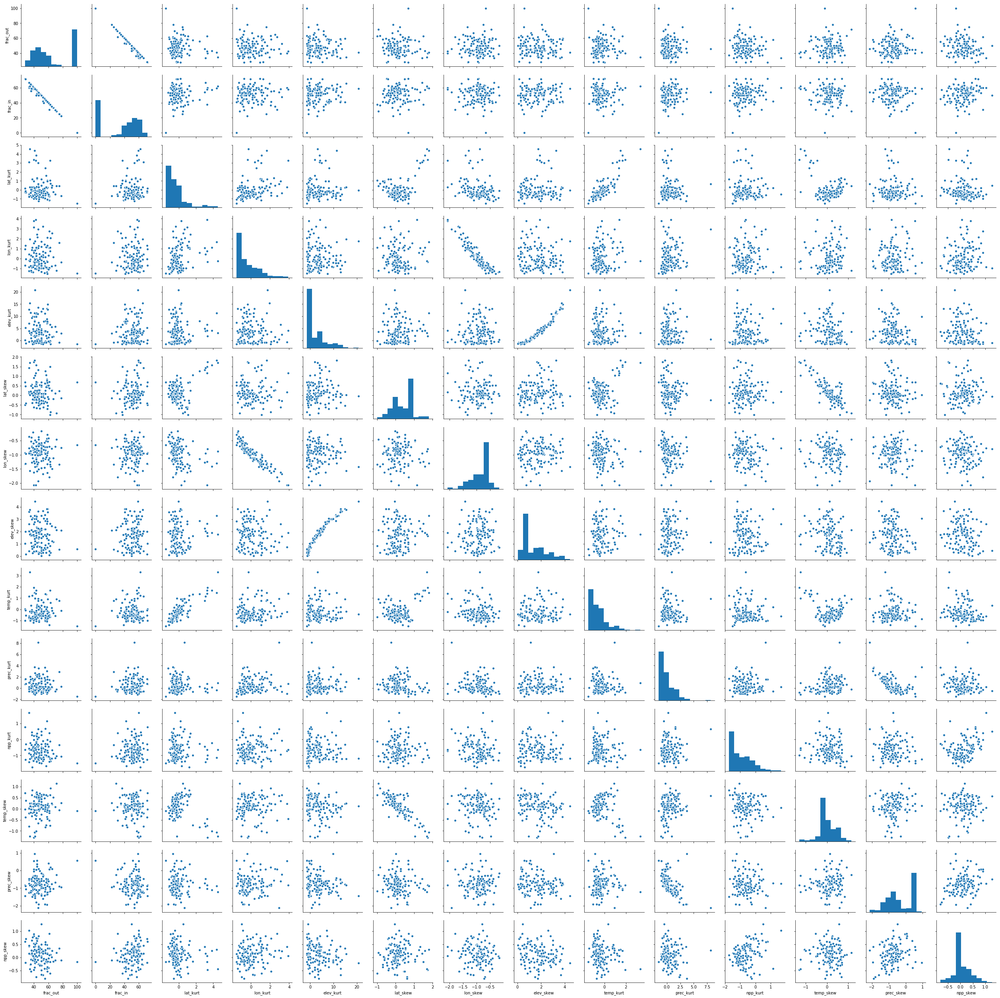

In [142]:
sns.pairplot(df_stats);

# rough observations:
# -most communities are composed of outdoor samples
# -frac_out is anti-correlated with frac_in (as expected)
# -lat_kurt is correlated with lat_skew, corr with temp_kurt
# -lon_kurt is anti-corr with lon_skew
# -elev_kurt is corr with elev_skew
# -lat_skew is corr with temp_kurt, anti with temp_skew
# -lon_skew is anti with long_kurt
# -elev_skew is corr with elev_kurt
# -temp_kurt is corr with lat_kurt
# -temp_skew is anti with lat_skew
# -prec_skew is anti with prec_kurt

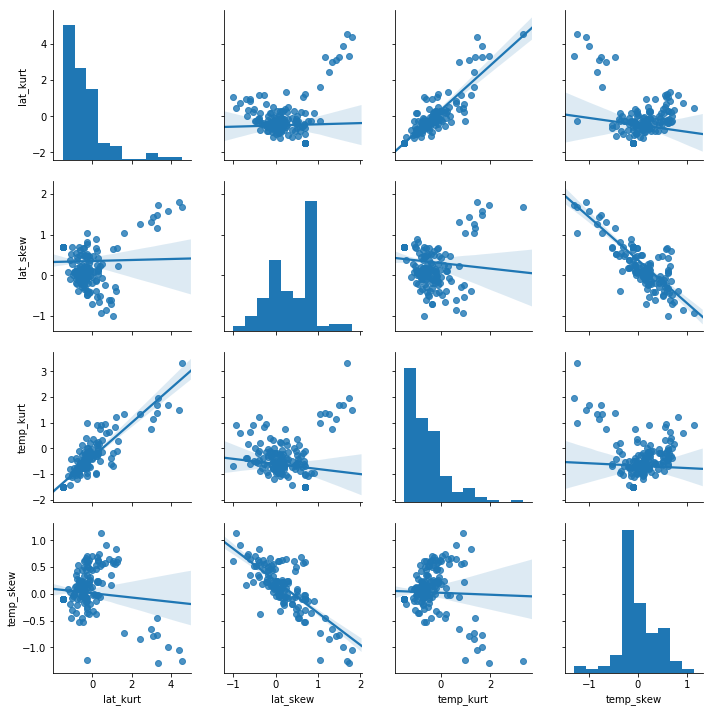

In [145]:
sns.pairplot(df_stats, vars=["lat_kurt","lat_skew","temp_kurt","temp_skew"],kind="reg")

In [113]:
# fraction of outdoor vs. indoor samples in a community
def plot_sample_type_pie(topic,dfnew,df):
    types = dfnew.loc[topic,'sample_types']
    outdoor_loc = np.where(np.asarray(types)==0)
    num_out = np.shape(outdoor_loc)[1]
    num_in = np.count_nonzero(types)
    num_other = len(types) - num_out - num_in
    labels = 'outdoor', 'indoor', 'not specified'
    sizes = [num_out,num_in,num_other]
    colors = ['green','blue','gray']
    explode = (0.1,0,0) # explode 1st slice
    plt.pie(sizes, explode=explode, labels=labels, colors=colors,
           autopct='%1.1f%%', shadow=True, startangle=140)
    plt.axis('equal')
    plt.title('community '+str(topic))
    plt.show()
    
# overlay community distributions with all; normalize
def plot_hist_for_topic(topic,dfnew,df):
    f, axarr = plt.subplots(3, 2)
    axarr[0, 0].hist(dfnew.loc[topic,'latitude'],color='b',alpha=0.25,label='community',normed=True)
    axarr[0, 0].hist(df['Latitude'],color='g',alpha=0.25,label='all',normed=True)
    axarr[0, 0].set_xlabel('latitude')
    axarr[0, 1].hist(dfnew.loc[topic,'longitude'],color='b',alpha=0.25,label='community',normed=True)
    axarr[0, 1].hist(df['Longitude'],color='g',alpha=0.25,label='all',normed=True)
    axarr[0, 1].set_xlabel('longitude')
    axarr[1, 0].hist(dfnew.loc[topic,'mean_ann_temp'],color='b',alpha=0.25,label='community',normed=True)
    axarr[1, 0].hist(df['MeanAnnual Temperature'],color='g',alpha=0.25,label='all',normed=True)
    axarr[1, 0].set_xlabel('mean annual temperature')
    axarr[1, 0].set_ylabel('counts')
    axarr[1, 1].hist(dfnew.loc[topic,'mean_ann_precip'],color='b',alpha=0.25,label='community',normed=True)
    axarr[1, 1].hist(df['MeanAnnualPrecipitation'],color='g',alpha=0.25,label='all',normed=True)
    axarr[1, 1].set_xlabel('mean annual precipitation')
    npp = dfnew.loc[topic,'net_prim_prod']
    npp = [n for n in npp if ~np.isnan(n)]
    axarr[2, 0].hist(npp,color='b',alpha=0.25,label='community',normed=True)
    npp_all = df['NetPrimaryProductivity']
    npp_all = [n for n in npp_all if ~np.isnan(n)]
    axarr[2, 0].hist(npp_all,color='g',alpha=0.25,label='all',normed=True)
    axarr[2, 0].set_xlabel('net primary productivity')
    axarr[2, 1].hist(dfnew.loc[topic,'elevation'],color='b',alpha=0.25,label='community',normed=True)
    axarr[2, 1].hist(df['Elevation'],color='g',alpha=0.25,label='all',normed=True)
    axarr[2, 1].set_xlabel('elevation')
    f.tight_layout()

    axarr[0, 0].set_title('community ' + str(topic))
    plt.legend()
    plt.show()
    #savefname = 'fungi_500_samples_com' + str(topic) + '_hist.png'
    #plt.savefig(savefname)
    
# only plot community distributions
def plot_hist_for_topic2(topic,dfnew,df):
    f, axarr = plt.subplots(3, 2)
    axarr[0, 0].hist(dfnew.loc[topic,'latitude'],color='b',alpha=0.25,label='community')
    axarr[0, 0].set_xlabel('latitude')
    axarr[0, 1].hist(dfnew.loc[topic,'longitude'],color='b',alpha=0.25,label='community')
    axarr[0, 1].set_xlabel('longitude')
    axarr[1, 0].hist(dfnew.loc[topic,'mean_ann_temp'],color='b',alpha=0.25,label='community')
    axarr[1, 0].set_xlabel('mean annual temperature')
    axarr[1, 0].set_ylabel('counts')
    axarr[1, 1].hist(dfnew.loc[topic,'mean_ann_precip'],color='b',alpha=0.25,label='community')
    axarr[1, 1].set_xlabel('mean annual precipitation')
    npp = dfnew.loc[topic,'net_prim_prod']
    npp = [n for n in npp if ~np.isnan(n)]
    axarr[2, 0].hist(npp,color='b',alpha=0.25,label='community')
    axarr[2, 0].set_xlabel('net primary productivity')
    axarr[2, 1].hist(dfnew.loc[topic,'elevation'],color='b',alpha=0.25,label='community')
    axarr[2, 1].set_xlabel('elevation')
    f.tight_layout()

    axarr[0, 0].set_title('community ' + str(topic))
    plt.show()
    #savefname = 'fungi_500_samples_com' + str(topic) + '_hist1.png'
    #plt.savefig(savefname)
    
def plot_cum_hist_for_topic(topic,dfnew,df,bins):
    f, axarr = plt.subplots(3, 2)
    values, base = np.histogram(dfnew.loc[topic,'latitude'],bins=bins)
    cum = np.cumsum(values)
    #values_a, base_a = np.histogram(df['Latitude'],bins=bins)
    #cum_a = np.cumsum(values_a)
    axarr[0, 0].plot(base[:-1],cum,c='blue')
    #axarr[0, 0].plot(base_a[:-1],cum_a,c='green')
    axarr[0, 0].set_xlabel('latitude')
    
    values, base = np.histogram(dfnew.loc[topic,'longitude'],bins=bins)
    cum = np.cumsum(values)
    axarr[0, 1].plot(base[:-1],cum,c='blue')
    axarr[0, 1].set_xlabel('longitude')
    
    values, base = np.histogram(dfnew.loc[topic,'mean_ann_temp'],bins=bins)
    cum = np.cumsum(values)
    axarr[1, 0].plot(base[:-1],cum,c='blue')
    axarr[1, 0].set_xlabel('mean annual temperature')
    axarr[1, 0].set_ylabel('counts')
    
    values, base = np.histogram(dfnew.loc[topic,'mean_ann_precip'],bins=bins)
    cum = np.cumsum(values)
    axarr[1, 1].plot(base[:-1],cum,c='blue')
    axarr[1, 1].set_xlabel('mean annual precipitation')
    
    npp = dfnew.loc[topic,'net_prim_prod']
    npp = [n for n in npp if ~np.isnan(n)]
    values, base = np.histogram(npp,bins=bins)
    cum = np.cumsum(values)
    axarr[2, 0].plot(base[:-1],cum,c='blue')
    axarr[2, 0].set_xlabel('net primary productivity')
    
    values, base = np.histogram(dfnew.loc[topic,'elevation'],bins=bins)
    cum = np.cumsum(values)
    axarr[2, 1].plot(base[:-1],cum,c='blue')
    axarr[2, 1].set_xlabel('elevation')
    f.tight_layout()

    axarr[0, 0].set_title('community ' + str(topic))
    plt.show()
    #savefname = 'fungi_500_samples_com' + str(topic) + '_cum.png'
    #plt.savefig(savefname)

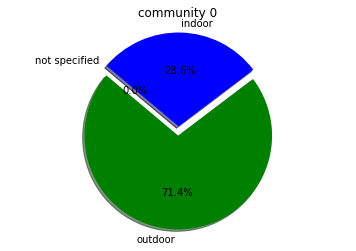

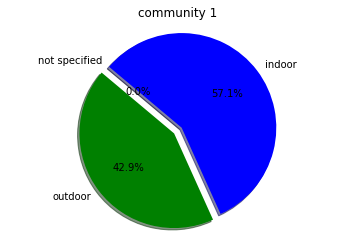

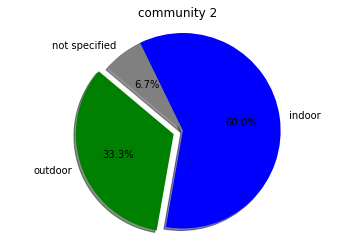

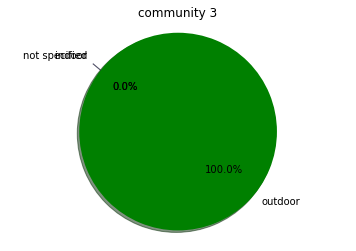

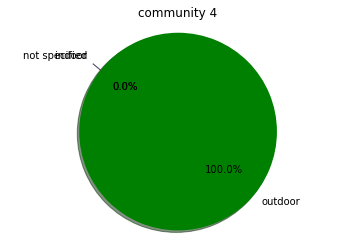

...

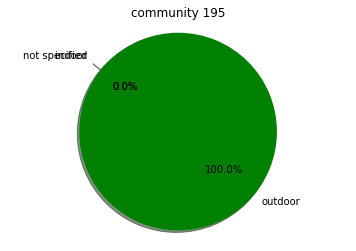

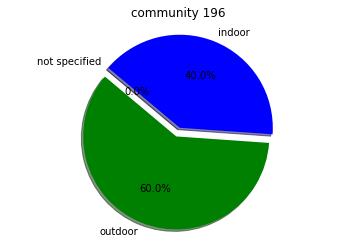

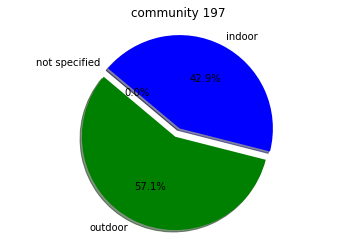

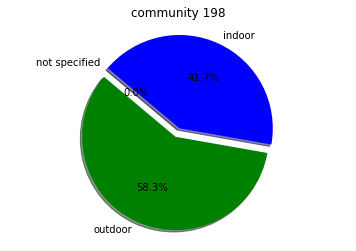

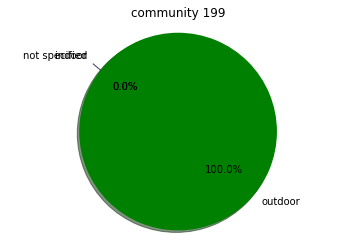

In [114]:
for t in index:
    plot_sample_type_pie(t,dfnew,df)

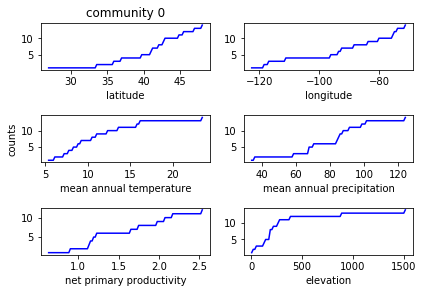

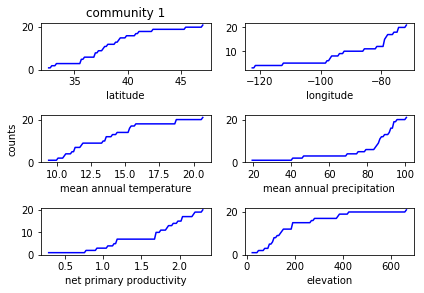

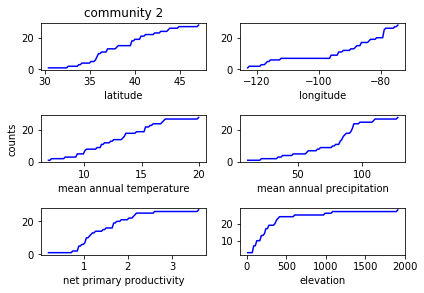

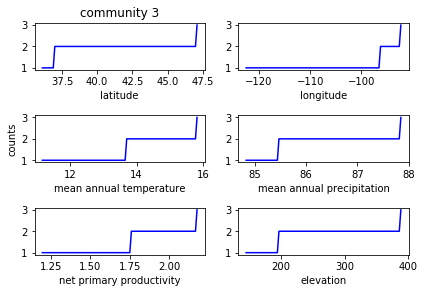

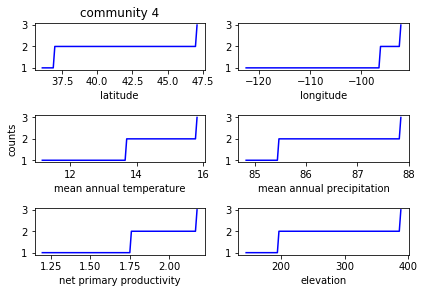

...

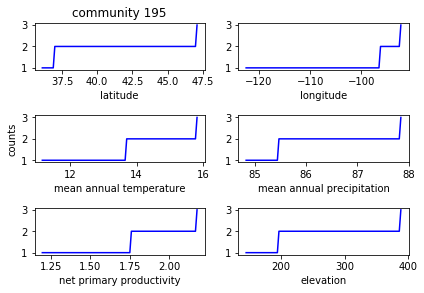

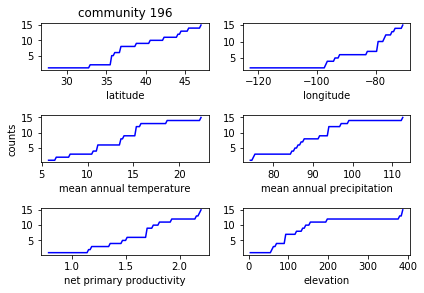

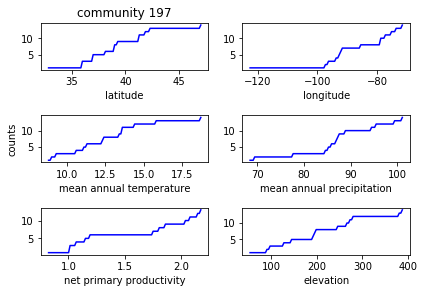

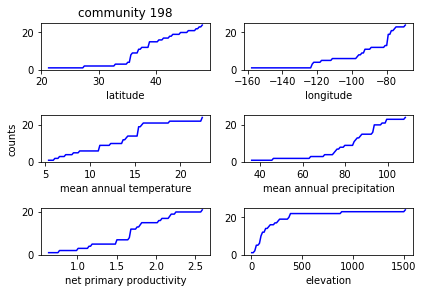

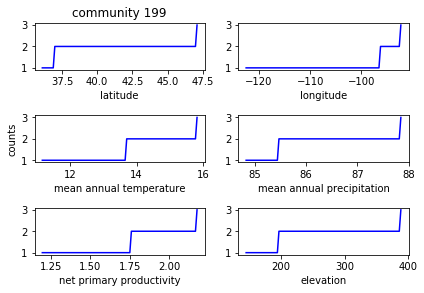

In [44]:
for t in index:
    plot_cum_hist_for_topic(t,dfnew,df,100)

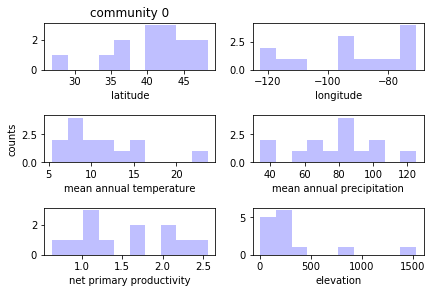

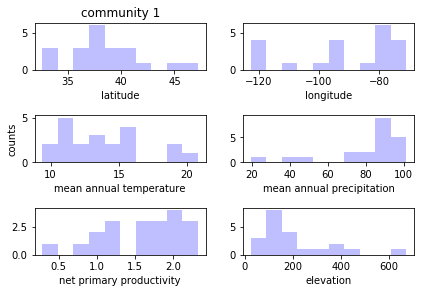

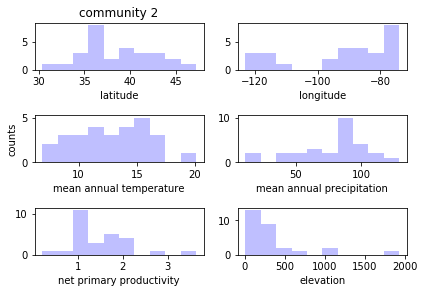

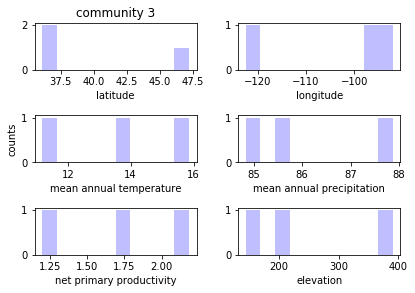

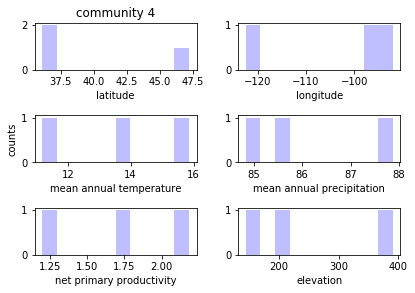

...

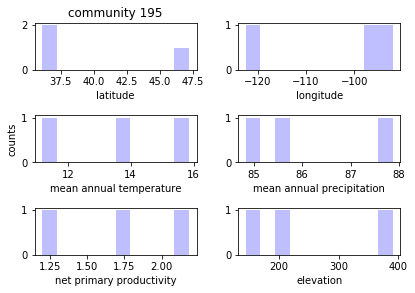

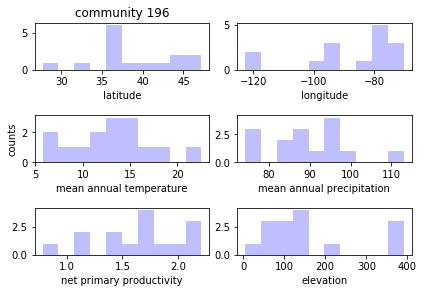

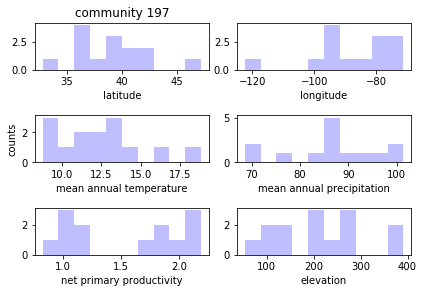

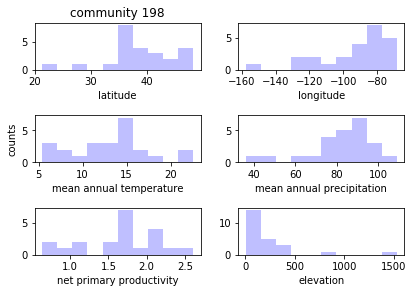

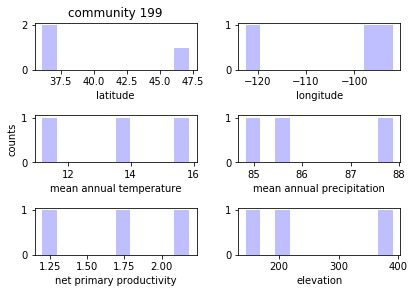

In [45]:
for t in index:
    plot_hist_for_topic2(t,dfnew,df)

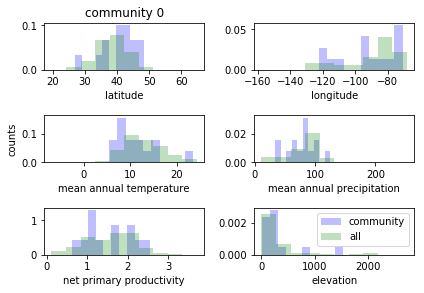

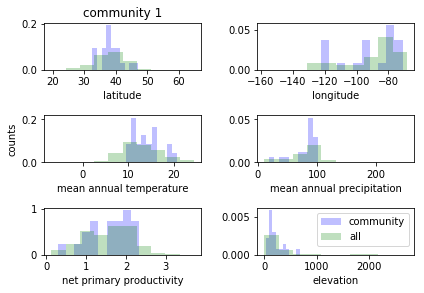

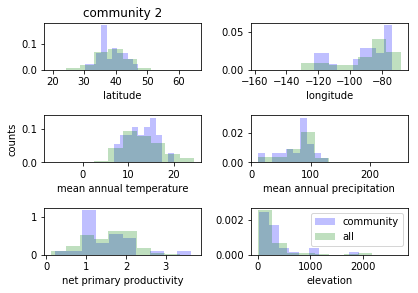

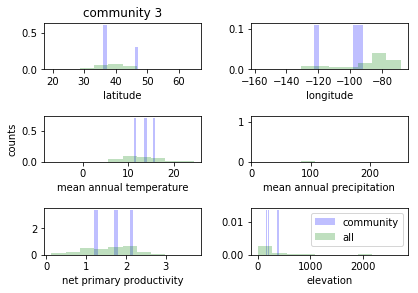

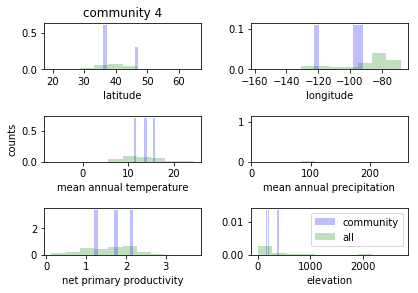

...

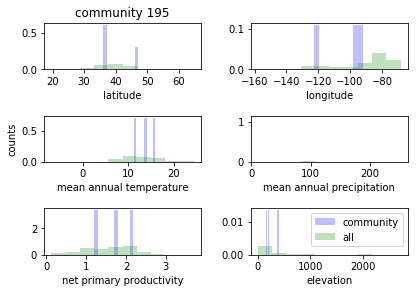

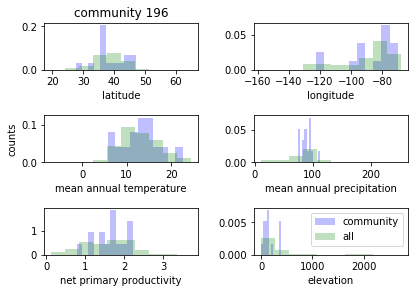

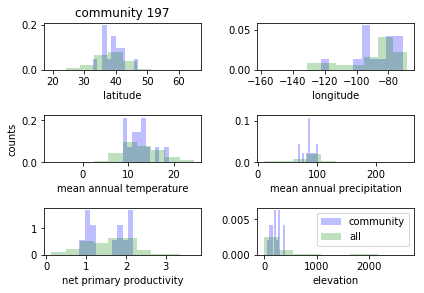

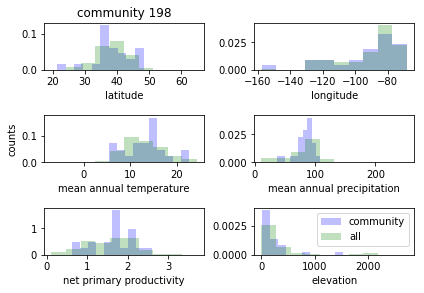

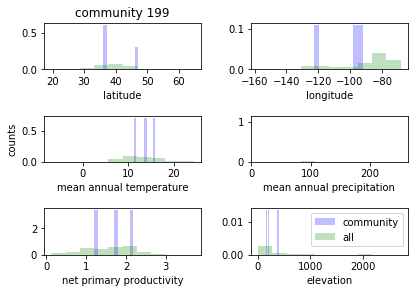

In [46]:
for t in index:
    plot_hist_for_topic(t,dfnew,df)

Now map the topics/communities geographically

In [47]:
def make_map_for_topic(topic,dfnew,df):
    #from mpl_toolkits.basemap import Basemap

    # llcrnrlat,llcrnrlon,urcrnrlat,urcrnrlon
    # are the lat/lon values of the lower left and upper right corners
    # of the map.
    # resolution = 'c' means use crude resolution coastlines.

    fig = plt.figure(figsize=(10,10))
    m = Basemap(projection='cyl',llcrnrlat=10,urcrnrlat=50,\
            llcrnrlon=-126,urcrnrlon=-55)

    m.drawcoastlines()
    m.drawstates()
    m.drawcountries()
    # add in locations where samples were taken
    lons = df['Longitude']
    lats = df['Latitude']
    x, y = m(lons,lats)
    m.scatter(x,y,3,marker='o',color='g',alpha=0.5)
    
    lons_c = dfnew.loc[topic,'longitude']
    lats_c = dfnew.loc[topic,'latitude']
    x_c, y_c = m(lons_c,lats_c)
    m.scatter(x_c,y_c,20,marker='x',color='r')
    
    plt.title('Community %d locations in red' % topic)
    plt.show()
    #savefname = 'fungi_500_samples_com' + str(topic) + '_map.png'
    #plt.savefig(savefname)

/home/melanie/anaconda2/envs/my_projects_env/lib/python2.7/site-packages/mpl_toolkits/basemap/__init__.py:3222: MatplotlibDeprecationWarning: The ishold function was deprecated in version 2.0.
  b = ax.ishold()
/home/melanie/anaconda2/envs/my_projects_env/lib/python2.7/site-packages/mpl_toolkits/basemap/__init__.py:3231: MatplotlibDeprecationWarning: axes.hold is deprecated.
    See the API Changes document (http://matplotlib.org/api/api_changes.html)
    for more details.
  ax.hold(b)


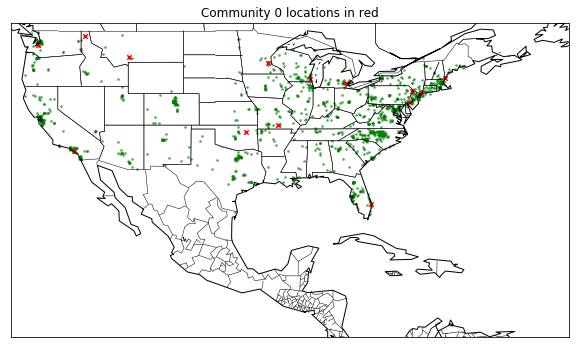

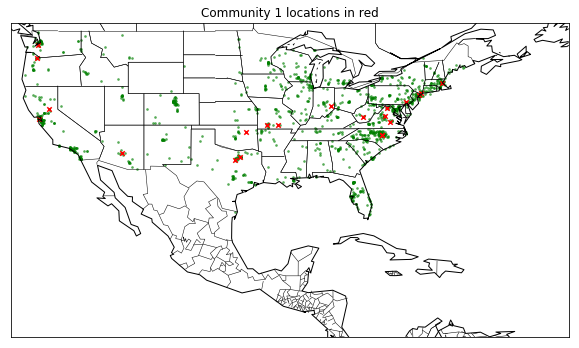

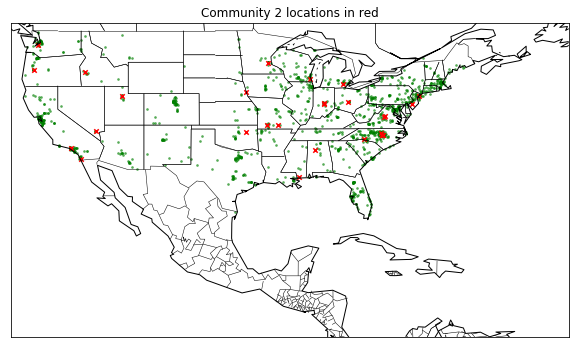

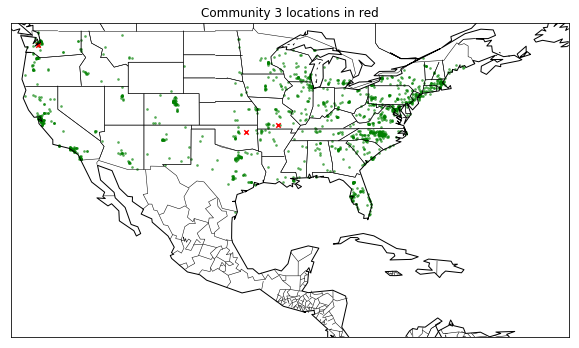

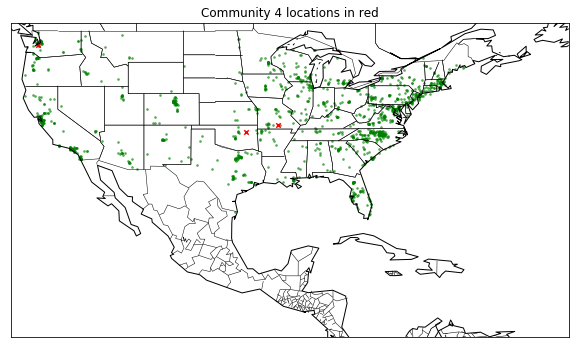

...

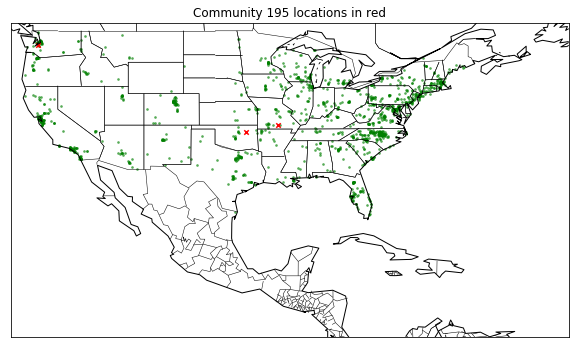

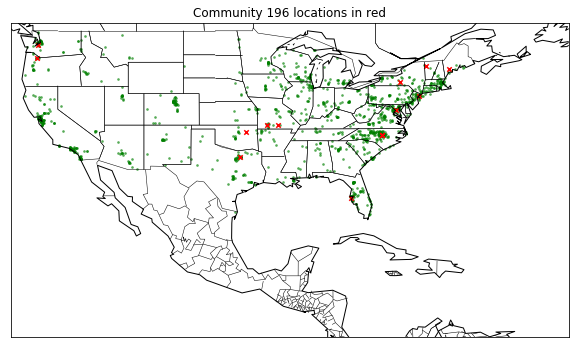

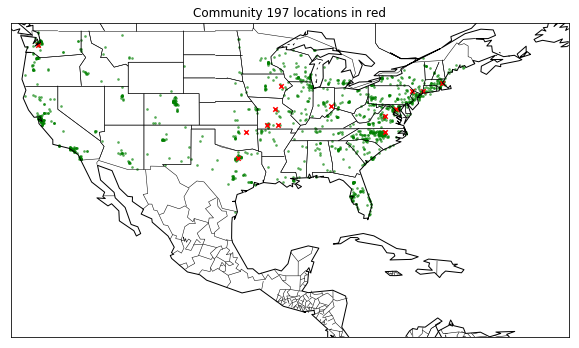

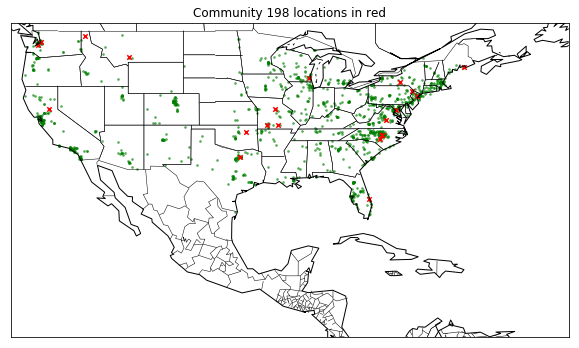

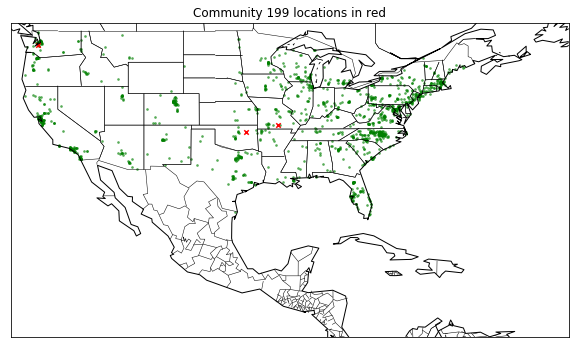

In [48]:
for t in index:
    make_map_for_topic(t,dfnew,df)
    

Make 3D scatter plot with plotly

Ref: https://plot.ly/python/3d-scatter-plots/

In [51]:
samp_ids = array(list(xrange(len(samples))))
#print(samp_ids)

In [52]:
from matplotlib import pyplot
from mpl_toolkits.mplot3d import Axes3D

# plot projection of articles onto 2 axes/topics defined by the model
def plot_3axes(x, y, z, tf_fit, samp_ids, labels):
    """Plot each article title according to the projection of its text 
    into the given x and y topic axes of model.
    
    :param x: the index of the x axis to plot
    :param y: the index of the y axis to plot
    :param tf_fit: the lda-transformed tf matrix
    :param samp_ids: a list of sample IDs (article titles)
    :param labels: a list of labels, indexed by sample IDs
    """
    x_data = defaultdict(list) 
    y_data = defaultdict(list) 
    z_data = defaultdict(list)
    arts = defaultdict(list)  
    for id in samp_ids:
        x_data[0].append(tf_fit[id][x]) 
        y_data[0].append(tf_fit[id][y])
        z_data[0].append(tf_fit[id][z])
        arts[0].append(labels[id])
    fig = pyplot.figure()
    ax = Axes3D(fig)    
    ax.scatter(list(x_data[0]), list(y_data[0]), list(z_data[0]),s=40)
    for art, x, y, z in zip(arts[0],x_data[0],y_data[0],z_data[0]):
        ax.text(x,y,z,  '%s' % (str(art)), size=10, zorder=1) 
    pyplot.show()

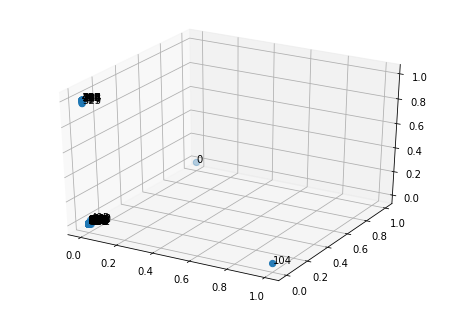

In [53]:
plot_3axes(x=0, y=1, z=2, tf_fit=tf_fit, samp_ids=samp_ids, labels=samp_ids)

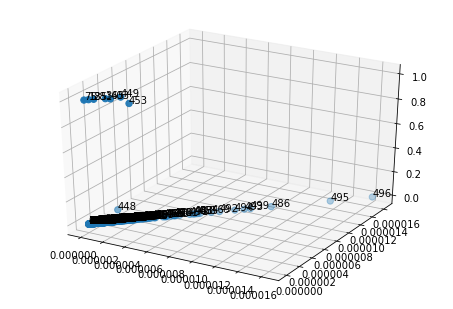

In [54]:
plot_3axes(x=3, y=4, z=5, tf_fit=tf_fit, samp_ids=samp_ids, labels=samp_ids)

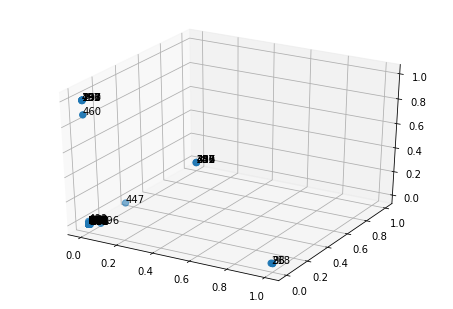

In [55]:
plot_3axes(x=6, y=7, z=8, tf_fit=tf_fit, samp_ids=samp_ids, labels=samp_ids)

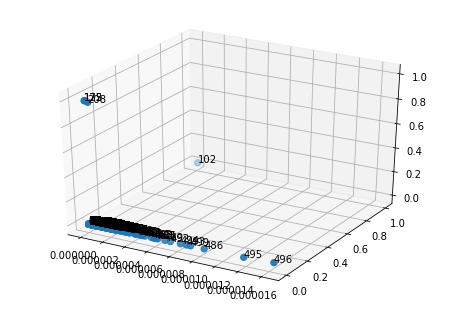

In [56]:
plot_3axes(x=9, y=10, z=11, tf_fit=tf_fit, samp_ids=samp_ids, labels=samp_ids)

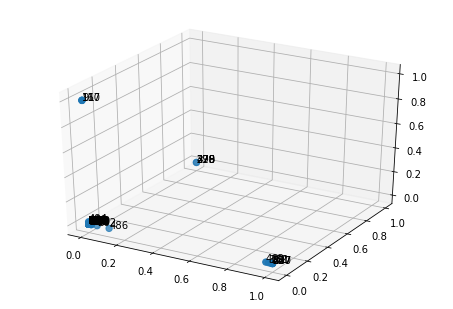

In [57]:
plot_3axes(x=20, y=30, z=40, tf_fit=tf_fit, samp_ids=samp_ids, labels=samp_ids)

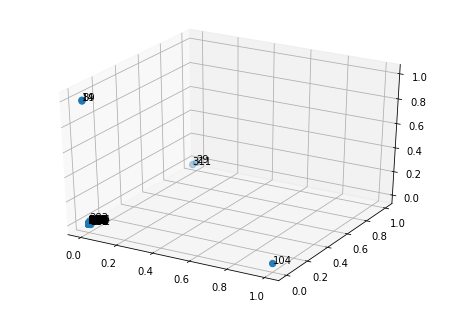

In [58]:
plot_3axes(x=0, y=50, z=100, tf_fit=tf_fit, samp_ids=samp_ids, labels=samp_ids)